In [1]:
import torch
import torchvision.transforms as transforms
from torchvision.datasets import ImageFolder
from torch.utils.data import DataLoader, Subset
from sklearn.model_selection import train_test_split
import numpy as np
import matplotlib.pyplot as plt

import torch.nn as nn
import torchvision.models as models
import time

import collections
import pandas as pd
from sklearn.metrics import confusion_matrix

from PIL import Image

# Bird species recognision using ResNet

## Data preparation

Train: 9430, Valid: 1179, Test: 1179


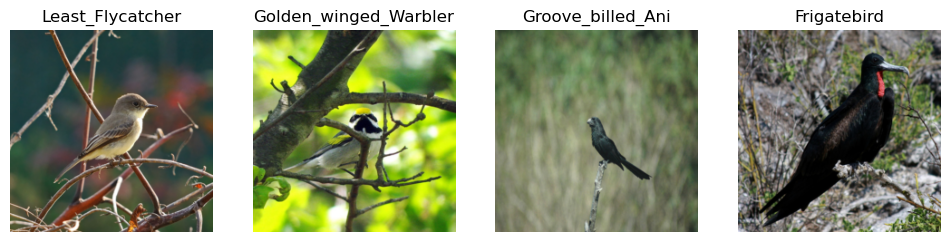

In [2]:
data_dir = './images'
BATCH_SIZE = 32
NUM_WORKERS = 0

# Standard ImageNet statistics for normalization (the average color of the entire ImageNet dataset)
stats = ((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))

simple_transform = transforms.Compose([
    transforms.Resize((224, 224)), 
    transforms.ToTensor(),
    transforms.Normalize(*stats) 
])

# get labels 
full_ds = ImageFolder(data_dir)
targets = full_ds.targets 

# Train - Temp 
train_idx, temp_idx = train_test_split(
    np.arange(len(targets)),
    test_size=0.2,
    shuffle=True,
    stratify=targets,
    random_state=42
)

temp_targets = np.array(targets)[temp_idx]

# Valid - Test split
val_idx, test_idx = train_test_split(
    temp_idx,
    test_size=0.5, 
    shuffle=True,
    stratify=temp_targets,
    random_state=42
)

print(f"Train: {len(train_idx)}, Valid: {len(val_idx)}, Test: {len(test_idx)}")

# DATASET & LOADERS
dataset = ImageFolder(data_dir, transform=simple_transform)

train_ds = Subset(dataset, train_idx)
val_ds   = Subset(dataset, val_idx)
test_ds  = Subset(dataset, test_idx)

train_dl = DataLoader(train_ds, batch_size=BATCH_SIZE, shuffle=True, num_workers=NUM_WORKERS)
val_dl   = DataLoader(val_ds, batch_size=BATCH_SIZE, shuffle=False, num_workers=NUM_WORKERS)
test_dl  = DataLoader(test_ds, batch_size=BATCH_SIZE, shuffle=False, num_workers=NUM_WORKERS)

def denormalize(img_tensor):
    return img_tensor * torch.tensor(stats[1]).view(3, 1, 1) + torch.tensor(stats[0]).view(3, 1, 1)

images, labels = next(iter(train_dl))

fig, axes = plt.subplots(1, 4, figsize=(12, 4))
for i in range(4):
    ax = axes[i]
    img = denormalize(images[i]).clamp(0, 1)
    ax.imshow(img.permute(1, 2, 0))
    ax.axis('off')
    class_name = full_ds.classes[labels[i]]
    ax.set_title(class_name.split('.')[-1])

plt.show()

### Tranformation vizualization

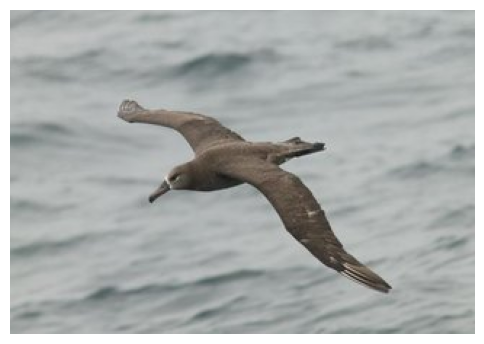

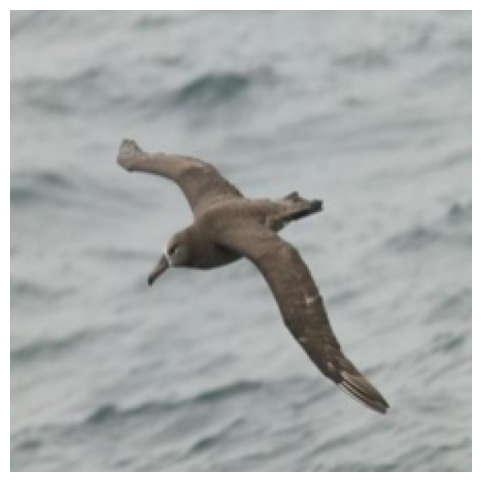

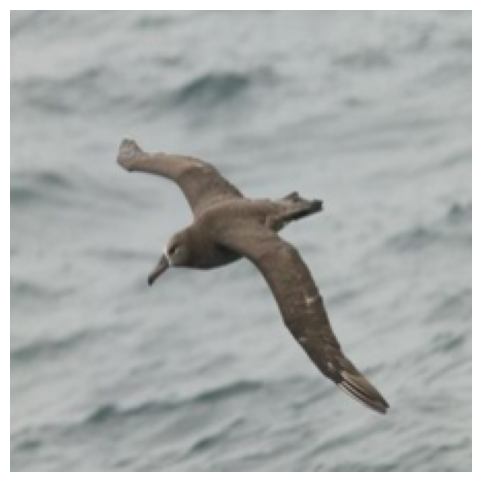

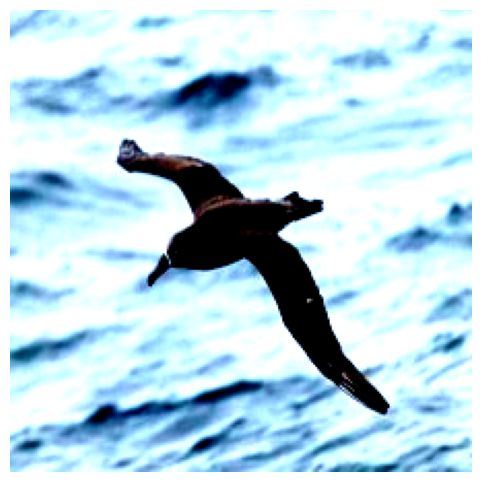

In [3]:
idx = 0 
img_original, label = full_ds[idx]

t_resize = transforms.Resize((224, 224))
t_tensor = transforms.ToTensor()
t_norm   = transforms.Normalize(*stats)

img_resized = t_resize(img_original)
img_tensor  = t_tensor(img_resized)
img_norm    = t_norm(img_tensor)

steps = [
    ("1. Original Image", img_original),
    ("2. Resized (224x224)", img_resized),
    ("3. ToTensor (0.0 - 1.0)", img_tensor.permute(1, 2, 0)), # Rearrange for display
    ("4. Normalized (Mean subtracted)", np.clip(img_norm.permute(1, 2, 0).numpy(), 0, 1)) # Clip for display
]

for title, img_data in steps:
    plt.figure(figsize=(6, 6))
    plt.imshow(img_data)
    plt.axis('off')
    plt.show()

# Model building

We build the model basing on ResNet50, changeing the final layer to match our classification problem. (200 outputs)

In [4]:
#  setup GPU 
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Selected: {device}")


def get_bird_model(num_classes):
    # Download ResNet50 (pre-trained)
    model = models.resnet50(weights="DEFAULT")
    
    for param in model.parameters():
        param.requires_grad = False # train only final layer
        
    # replace final layer of original ResNet
    in_features = model.fc.in_features #take what final leayer was fed initially
    model.fc = nn.Sequential(
        nn.Linear(in_features, 256), 
        nn.ReLU(),
        nn.Dropout(0.3),             # Prevents overfitting (randomly turns off neurons)
        nn.Linear(256, num_classes)  # output: 200 bird scores
    )
    
    return model.to(device)

# Initialize the model
num_classes = len(full_ds.classes) 
model = get_bird_model(num_classes)
print(f"Otput classes: {num_classes}")

# Loss (multi-class problem)
criterion = nn.CrossEntropyLoss()

# only optimize final layer
optimizer = torch.optim.Adam(model.fc.parameters(), lr=0.001)

def evaluate(model, data_loader):
    """Calculates accuracy on validation or test set."""
    model.eval() # Set to evaluation mode (no Dropout)
    correct = 0
    total = 0
    
    with torch.no_grad(): # no gradients
        for images, labels in data_loader:
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
            
    return 100 * correct / total

def train_one_epoch(model, loader, optimizer, criterion):
    model.train()
    running_loss = 0.0
    
    for i, (images, labels) in enumerate(loader):
        images, labels = images.to(device), labels.to(device)
        
        # Forward
        outputs = model(images)
        loss = criterion(outputs, labels)
        
        # Backward
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        running_loss += loss.item()
        
    return running_loss / len(loader)

Selected: cuda
Otput classes: 200


## Training

training for 7 epochs
Epoch [1/7] | Train Loss: 4.1724 | Val Accuracy: 30.53%
Epoch [2/7] | Train Loss: 2.4669 | Val Accuracy: 44.19%
Epoch [3/7] | Train Loss: 1.8446 | Val Accuracy: 51.23%
Epoch [4/7] | Train Loss: 1.5015 | Val Accuracy: 52.93%
Epoch [5/7] | Train Loss: 1.2611 | Val Accuracy: 56.40%
Epoch [6/7] | Train Loss: 1.0672 | Val Accuracy: 56.32%
Epoch [7/7] | Train Loss: 0.9274 | Val Accuracy: 58.78%
Training Complete, tiem: 6.28 min
Final Test Set Accuracy: 57.17%


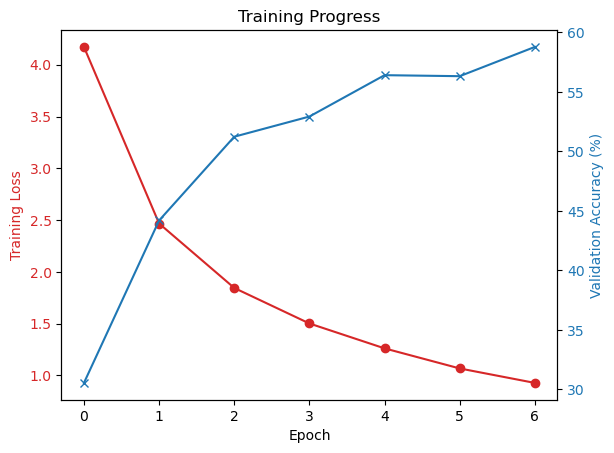

 Model saved as bird_classifier_resnet50.pth


In [5]:
num_epochs = 7  # 10 or 20 ?
history = {'train_loss': [], 'val_acc': []}

print(f"training for {num_epochs} epochs")

start_time = time.time()

for epoch in range(num_epochs):
    # Train
    train_loss = train_one_epoch(model, train_dl, optimizer, criterion)
    
    # Validate
    val_acc = evaluate(model, val_dl)
    
    history['train_loss'].append(train_loss)
    history['val_acc'].append(val_acc)
    
    print(f"Epoch [{epoch+1}/{num_epochs}] | "
          f"Train Loss: {train_loss:.4f} | "
          f"Val Accuracy: {val_acc:.2f}%")

total_time = time.time() - start_time
print(f"Training Complete, tiem: {total_time/60:.2f} min")

test_acc = evaluate(model, test_dl)
print(f"Final Test Set Accuracy: {test_acc:.2f}%")

# loss curve
fig, ax1 = plt.subplots()

color = 'tab:red'
ax1.set_xlabel('Epoch')
ax1.set_ylabel('Training Loss', color=color)
ax1.plot(history['train_loss'], color=color, marker='o')
ax1.tick_params(axis='y', labelcolor=color)

ax2 = ax1.twinx()  # Instantiate a second axes that shares the same x-axis
color = 'tab:blue'
ax2.set_ylabel('Validation Accuracy (%)', color=color)
ax2.plot(history['val_acc'], color=color, marker='x')
ax2.tick_params(axis='y', labelcolor=color)

plt.title("Training Progress")
plt.show()

filename = 'bird_classifier_resnet50.pth'
torch.save(model.state_dict(), filename)
print(f" Model saved as {filename}")

### Results

In [6]:
train_refs = {}

for idx in train_ds.indices:
    label = full_ds.targets[idx]
    if label not in train_refs:
        train_refs[label] = dataset[idx][0] 
    
    if len(train_refs) == len(full_ds.classes):
        break

def get_predictions_and_errors(loader, model):
    y_true = []
    y_pred = []
    error_indices = collections.defaultdict(list)
    
    model.eval()
    with torch.no_grad():
        global_idx = 0
        for images, labels in loader:
            images = images.to(device)
            outputs = model(images)
            _, predicted = torch.max(outputs, 1)
            
            lbls = labels.cpu().numpy()
            preds = predicted.cpu().numpy()
            
            y_true.extend(lbls)
            y_pred.extend(preds)
            
            for i in range(len(lbls)):
                t = int(lbls[i])
                p = int(preds[i])
                if t != p:
                    error_indices[(t, p)].append(global_idx + i)
            
            global_idx += len(images)
            
    return y_true, y_pred, error_indices

y_true, y_pred, error_map = get_predictions_and_errors(test_dl, model)

conf_mat = confusion_matrix(y_true, y_pred)

confused_pairs = []
for i in range(len(full_ds.classes)):
    for j in range(len(full_ds.classes)):
        if i != j and conf_mat[i, j] > 0:
            confused_pairs.append({
                'True Bird': full_ds.classes[i].split('.')[-1],
                'Predicted Bird': full_ds.classes[j].split('.')[-1],
                'Count': conf_mat[i, j]
            })

df_conf = pd.DataFrame(confused_pairs).sort_values(by='Count', ascending=False)
N_CONFUSED = 15
print("MOST CONFUSED PAIRS:")
print(df_conf.head(N_CONFUSED).to_string(index=False))

MOST CONFUSED PAIRS:
             True Bird            Predicted Bird  Count
        Whip_poor_Will          Chuck_will_Widow      4
          Common_Raven             American_Crow      4
       Scarlet_Tanager            Summer_Tanager      4
           Common_Tern                Artic_Tern      4
           Winter_Wren                House_Wren      4
        Lazuli_Bunting             Blue_Grosbeak      4
         Cliff_Swallow              Barn_Swallow      3
             Fish_Crow             American_Crow      3
  Glaucous_winged_Gull          Ring_billed_Gull      3
          Elegant_Tern              Caspian_Tern      3
        Hooded_Warbler      Prothonotary_Warbler      3
        Indigo_Bunting             Blue_Grosbeak      3
    Rufous_Hummingbird Ruby_throated_Hummingbird      2
       Mangrove_Cuckoo      Yellow_billed_Cuckoo      2
Orange_crowned_Warbler              Pine_Warbler      2


In [7]:
class_accuracy = conf_mat.diagonal() / conf_mat.sum(axis=1)
class_accuracy = np.nan_to_num(class_accuracy) 
worst_indices = class_accuracy.argsort()[:N_CONFUSED]

print("HARDEST BIRDS TO CLASSIFY (Lowest Accuracy):")
for idx in worst_indices:
    bird_name = full_ds.classes[idx].split('.')[-1]
    acc = class_accuracy[idx] * 100
    print(f"{bird_name}: {acc:.1f}% accuracy")

HARDEST BIRDS TO CLASSIFY (Lowest Accuracy):
Shiny_Cowbird: 0.0% accuracy
Mangrove_Cuckoo: 0.0% accuracy
California_Gull: 0.0% accuracy
Acadian_Flycatcher: 0.0% accuracy
Orchard_Oriole: 0.0% accuracy
Tennessee_Warbler: 0.0% accuracy
Elegant_Tern: 0.0% accuracy
Red_eyed_Vireo: 0.0% accuracy
Herring_Gull: 16.7% accuracy
Grasshopper_Sparrow: 16.7% accuracy
Loggerhead_Shrike: 16.7% accuracy
Common_Raven: 16.7% accuracy
House_Sparrow: 16.7% accuracy
Great_Crested_Flycatcher: 16.7% accuracy
Fish_Crow: 16.7% accuracy


Inspecting: True 'Whip_poor_Will' vs Pred 'Chuck_will_Widow'


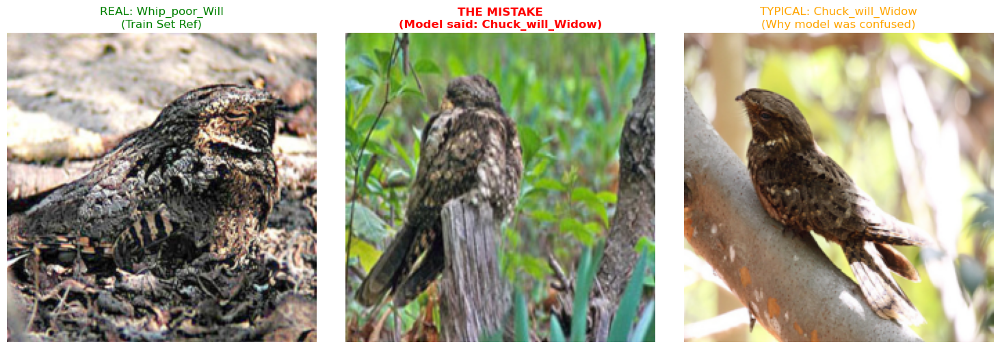

Inspecting: True 'Common_Raven' vs Pred 'American_Crow'


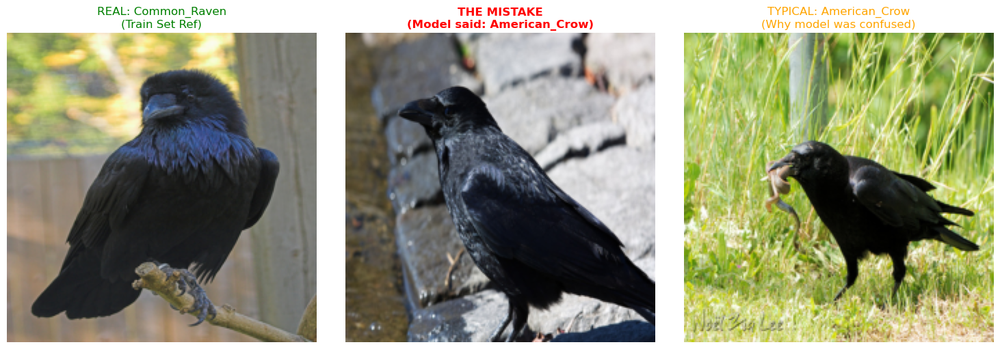

Inspecting: True 'Scarlet_Tanager' vs Pred 'Summer_Tanager'


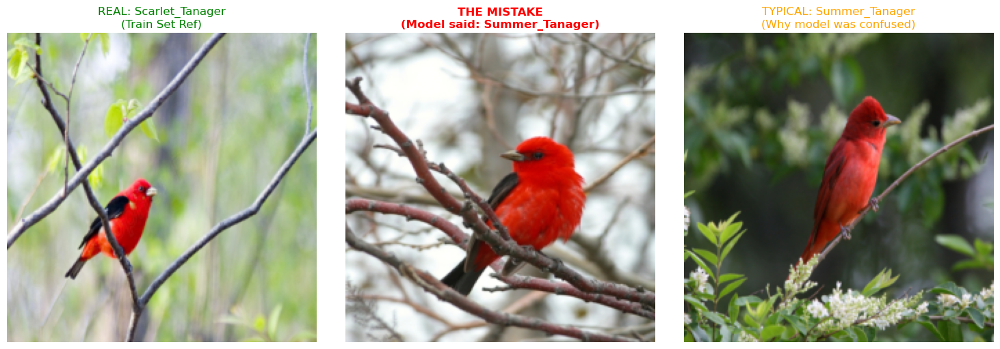

Inspecting: True 'Common_Tern' vs Pred 'Artic_Tern'


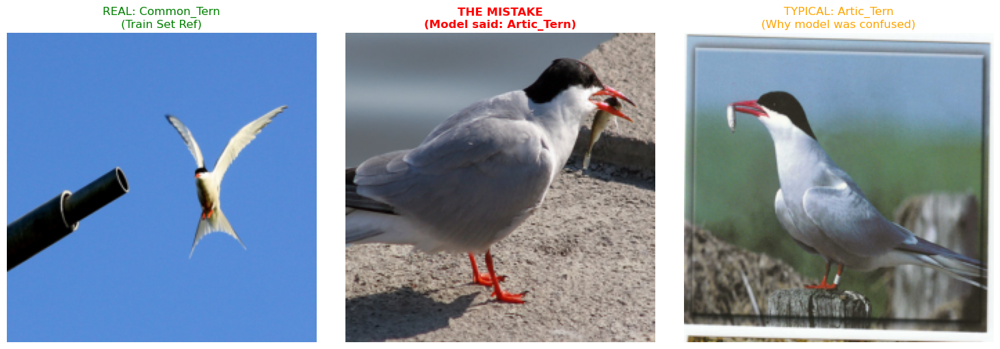

Inspecting: True 'Winter_Wren' vs Pred 'House_Wren'


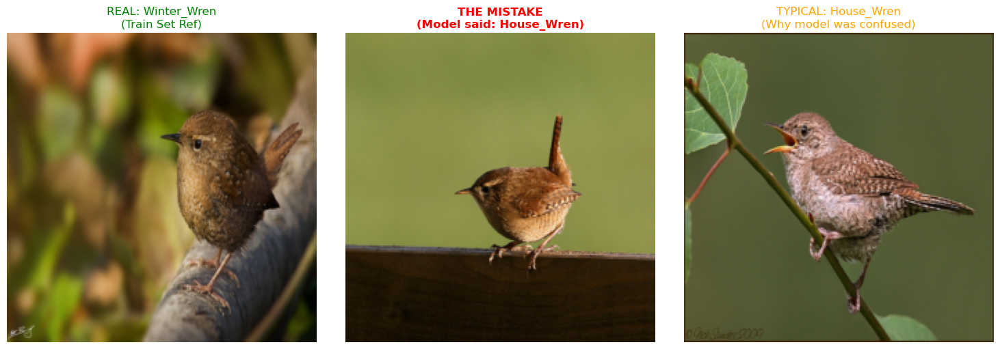

In [8]:
def plot_mistake(true_name, pred_name):
    true_idx = next(i for i, n in enumerate(full_ds.classes) if true_name in n)
    pred_idx = next(i for i, n in enumerate(full_ds.classes) if pred_name in n)

    print(f"Inspecting: True '{true_name}' vs Pred '{pred_name}'")

    indices = error_map.get((true_idx, pred_idx), [])
    if not indices:
        print("   (No mistakes found for this pair in this run)")
        return
    img_mistake, _ = test_ds[indices[0]]

    img_real = train_refs.get(true_idx)
    img_pred_ref = train_refs.get(pred_idx)

    fig, axes = plt.subplots(1, 3, figsize=(15, 5))
    
    axes[0].imshow(denormalize(img_real).permute(1, 2, 0).clamp(0, 1))
    axes[0].set_title(f"REAL: {true_name}\n(Train Set Ref)", color='green')
    axes[0].axis('off')

    axes[1].imshow(denormalize(img_mistake).permute(1, 2, 0).clamp(0, 1))
    axes[1].set_title(f"THE MISTAKE\n(Model said: {pred_name})", color='red', fontweight='bold')
    axes[1].axis('off')

    axes[2].imshow(denormalize(img_pred_ref).permute(1, 2, 0).clamp(0, 1))
    axes[2].set_title(f"TYPICAL: {pred_name}\n(Why model was confused)", color='orange')
    axes[2].axis('off')
    
    plt.tight_layout()
    plt.show()

for i in range(min(5, len(df_conf))):
    row = df_conf.iloc[i]
    plot_mistake(row['True Bird'], row['Predicted Bird'])

## Try the model on outsourced photo

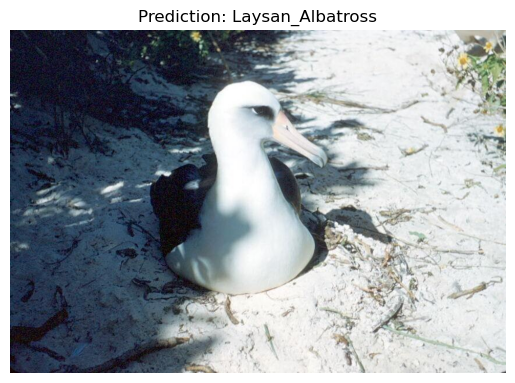

Model Predictions:
1. Laysan_Albatross: 44.83%
2. Northern_Fulmar: 18.05%
3. Sooty_Albatross: 12.83%


In [9]:
def predict_local_image(image_path):
    try:
        img = Image.open(image_path).convert('RGB')
        
        transform = transforms.Compose([
            transforms.Resize((224, 224)),
            transforms.ToTensor(),
            transforms.Normalize(*stats)
        ])
        
        img_tensor = transform(img).unsqueeze(0).to(device) 
        
        model.eval() # Turn off training mode
        with torch.no_grad():
            outputs = model(img_tensor)
            probabilities = torch.nn.functional.softmax(outputs[0], dim=0)
            
            # Get Top 3
            top3_prob, top3_idx = torch.topk(probabilities, 3)
            
        plt.imshow(img)
        plt.axis('off')
        plt.title(f"Prediction: {full_ds.classes[top3_idx[0]].split('.')[-1]}")
        plt.show()
        
        print("Model Predictions:")
        for i in range(3):
            class_name = full_ds.classes[top3_idx[i]].split('.')[-1]
            score = top3_prob[i].item() * 100
            print(f"{i+1}. {class_name}: {score:.2f}%")
            
    except FileNotFoundError:
        print(f"Error: Could not find file '{image_path}'. Make sure it's in the same folder as your notebook!")
    except Exception as e:
        print(f"Error processing image: {e}")

predict_local_image('test_bird.jpg')

## Fine-tuning

In [10]:
# enable learning for 'layer4' block of ResNet
for param in model.layer4.parameters():
    param.requires_grad = True

optimizer = torch.optim.Adam([
    {'params': model.layer4.parameters(), 'lr': 1e-4}, # Low LR so that not to break the pre-trained model
    {'params': model.fc.parameters(),     'lr': 1e-3}
])

# 3. Train for more epochs
fine_tune_epochs = 8
print(f"Fine-Tuning for {fine_tune_epochs} epochs")

for epoch in range(fine_tune_epochs):
    # Train
    train_loss = train_one_epoch(model, train_dl, optimizer, criterion)
    
    # Validate
    val_acc = evaluate(model, val_dl)
    
    # Record & Print
    history['train_loss'].append(train_loss)
    history['val_acc'].append(val_acc)
    
    print(f"Fine-Tune Epoch [{epoch+1}/{fine_tune_epochs}] | "
          f"Train Loss: {train_loss:.4f} | "
          f"Val Accuracy: {val_acc:.2f}%")

final_acc = evaluate(model, test_dl)
print(f"Test Set Accuracy: {final_acc:.2f}%")

torch.save(model.state_dict(), 'bird_classifier_finetuned.pth')

Fine-Tuning for 8 epochs
Fine-Tune Epoch [1/8] | Train Loss: 0.7406 | Val Accuracy: 68.11%
Fine-Tune Epoch [2/8] | Train Loss: 0.3565 | Val Accuracy: 68.96%
Fine-Tune Epoch [3/8] | Train Loss: 0.2069 | Val Accuracy: 68.53%
Fine-Tune Epoch [4/8] | Train Loss: 0.1426 | Val Accuracy: 72.77%
Fine-Tune Epoch [5/8] | Train Loss: 0.1072 | Val Accuracy: 70.82%
Fine-Tune Epoch [6/8] | Train Loss: 0.0871 | Val Accuracy: 72.01%
Fine-Tune Epoch [7/8] | Train Loss: 0.0654 | Val Accuracy: 70.48%
Fine-Tune Epoch [8/8] | Train Loss: 0.0679 | Val Accuracy: 71.76%
Test Set Accuracy: 71.50%


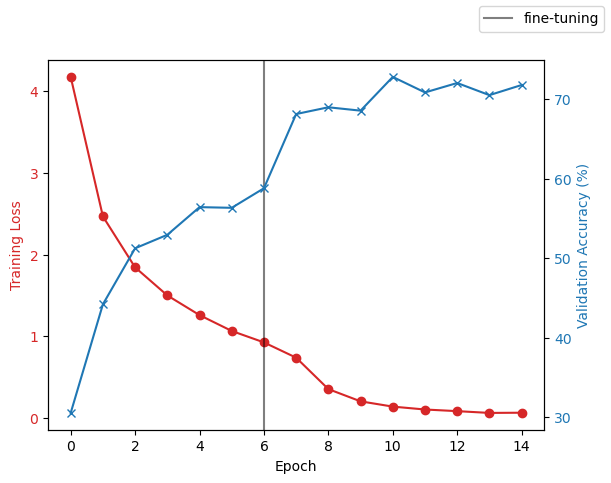

In [11]:
# loss curve
fig, ax1 = plt.subplots()

color = 'tab:red'
ax1.set_xlabel('Epoch')
ax1.set_ylabel('Training Loss', color=color)
ax1.plot(history['train_loss'], color=color, marker='o')
ax1.tick_params(axis='y', labelcolor=color)

ax2 = ax1.twinx()  # Instantiate a second axes that shares the same x-axis
color = 'tab:blue'
ax1.axvline(6, label='fine-tuning', color='k', alpha = 0.5)
ax2.set_ylabel('Validation Accuracy (%)', color=color)
ax2.plot(history['val_acc'], color=color, marker='x')
ax2.tick_params(axis='y', labelcolor=color)
fig.legend()


In [12]:
y_true, y_pred, error_map = get_predictions_and_errors(test_dl, model)

conf_mat = confusion_matrix(y_true, y_pred)

confused_pairs = []
for i in range(len(full_ds.classes)):
    for j in range(len(full_ds.classes)):
        if i != j and conf_mat[i, j] > 0:
            confused_pairs.append({
                'True Bird': full_ds.classes[i].split('.')[-1],
                'Predicted Bird': full_ds.classes[j].split('.')[-1],
                'Count': conf_mat[i, j]
            })

df_conf = pd.DataFrame(confused_pairs).sort_values(by='Count', ascending=False)
N_CONFUSED = 15
print("MOST CONFUSED PAIRS:")
print(df_conf.head(N_CONFUSED).to_string(index=False))

class_accuracy = conf_mat.diagonal() / conf_mat.sum(axis=1)
class_accuracy = np.nan_to_num(class_accuracy) 
worst_indices = class_accuracy.argsort()[:N_CONFUSED]

MOST CONFUSED PAIRS:
             True Bird            Predicted Bird  Count
          Western_Gull           California_Gull      3
           Frigatebird           Sooty_Albatross      3
       California_Gull          Ring_billed_Gull      3
           Common_Tern                Artic_Tern      3
         Forsters_Tern               Common_Tern      3
      Bohemian_Waxwing             Cedar_Waxwing      3
      Brewer_Blackbird       Boat_tailed_Grackle      3
         American_Crow              Common_Raven      3
Olive_sided_Flycatcher        Western_Wood_Pewee      2
          Herring_Gull          Ring_billed_Gull      2
   Blue_winged_Warbler         Tropical_Kingbird      2
     Great_Grey_Shrike         Loggerhead_Shrike      2
    Acadian_Flycatcher Yellow_bellied_Flycatcher      2
     Ringed_Kingfisher         Belted_Kingfisher      2
      Green_Kingfisher         Belted_Kingfisher      2


In [13]:
print("HARDEST BIRDS TO CLASSIFY (Lowest Accuracy):")
for idx in worst_indices:
    bird_name = full_ds.classes[idx].split('.')[-1]
    acc = class_accuracy[idx] * 100
    print(f"{bird_name}: {acc:.1f}% accuracy")

HARDEST BIRDS TO CLASSIFY (Lowest Accuracy):
Shiny_Cowbird: 0.0% accuracy
American_Crow: 0.0% accuracy
California_Gull: 0.0% accuracy
Savannah_Sparrow: 0.0% accuracy
Tennessee_Warbler: 0.0% accuracy
Western_Gull: 16.7% accuracy
Elegant_Tern: 16.7% accuracy
Western_Wood_Pewee: 16.7% accuracy
Cactus_Wren: 16.7% accuracy
Slaty_backed_Gull: 20.0% accuracy
Acadian_Flycatcher: 33.3% accuracy
Yellow_bellied_Flycatcher: 33.3% accuracy
Olive_sided_Flycatcher: 33.3% accuracy
Pigeon_Guillemot: 33.3% accuracy
Glaucous_winged_Gull: 33.3% accuracy


Inspecting: True 'Western_Gull' vs Pred 'California_Gull'


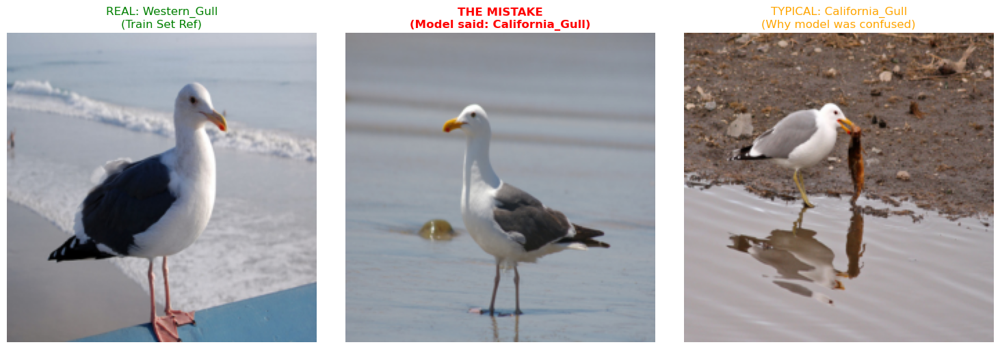

Inspecting: True 'Frigatebird' vs Pred 'Sooty_Albatross'


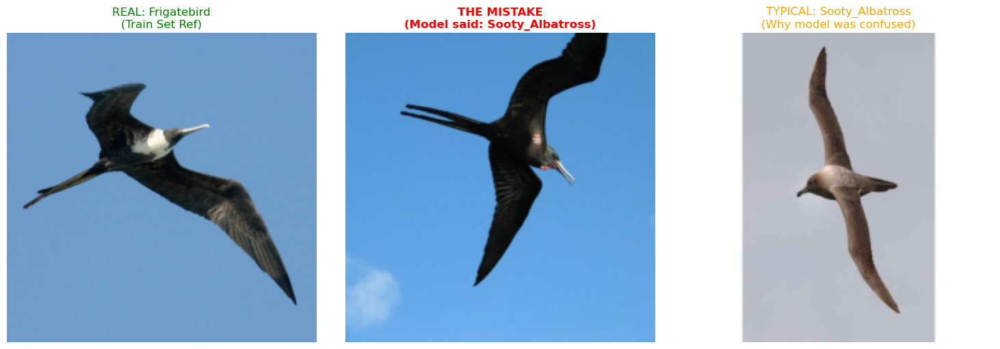

Inspecting: True 'California_Gull' vs Pred 'Ring_billed_Gull'


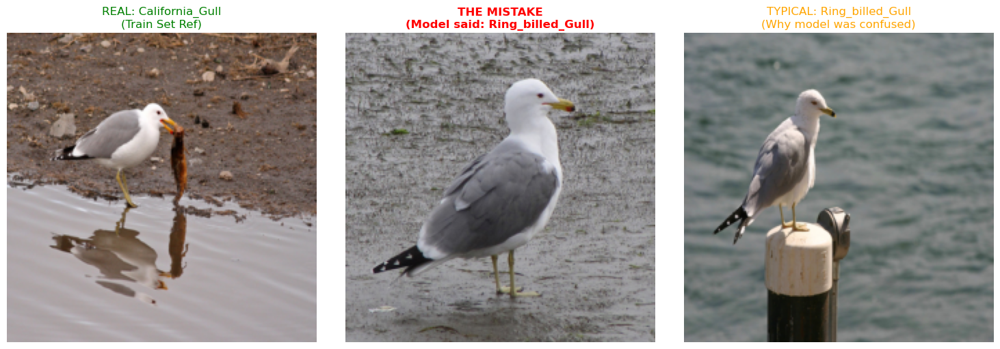

Inspecting: True 'Common_Tern' vs Pred 'Artic_Tern'


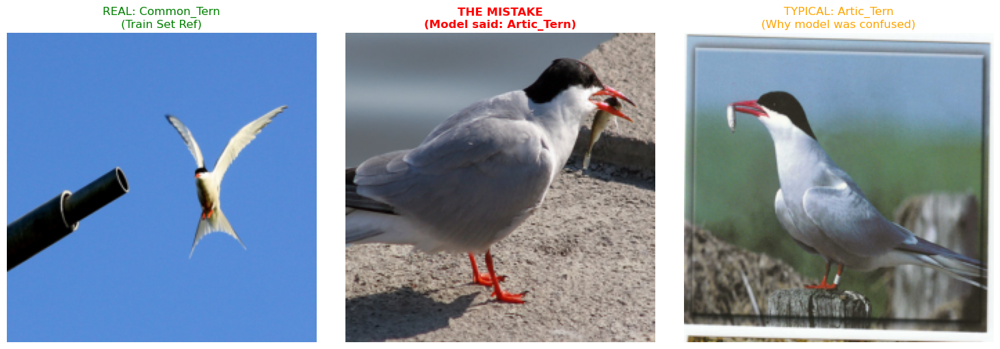

Inspecting: True 'Forsters_Tern' vs Pred 'Common_Tern'


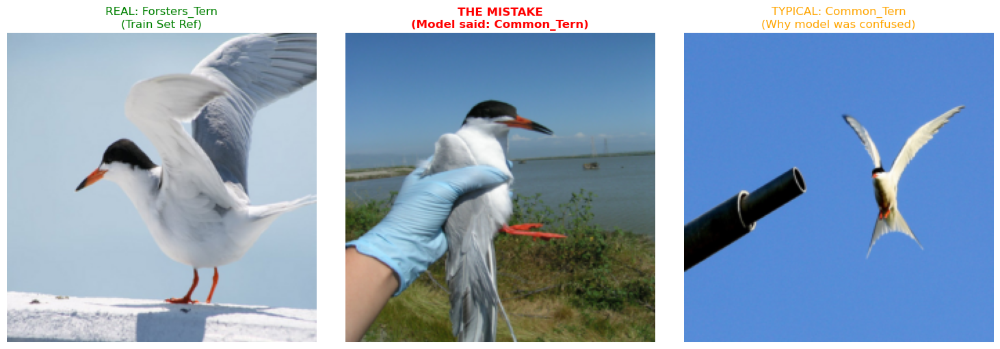

Inspecting: True 'Bohemian_Waxwing' vs Pred 'Cedar_Waxwing'


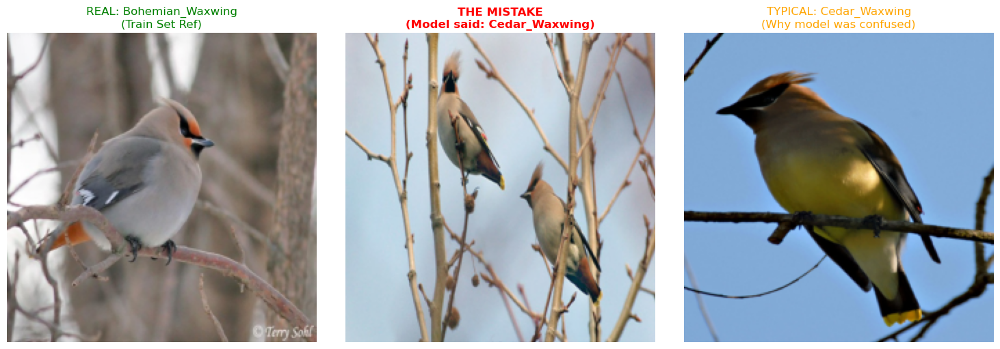

Inspecting: True 'Brewer_Blackbird' vs Pred 'Boat_tailed_Grackle'


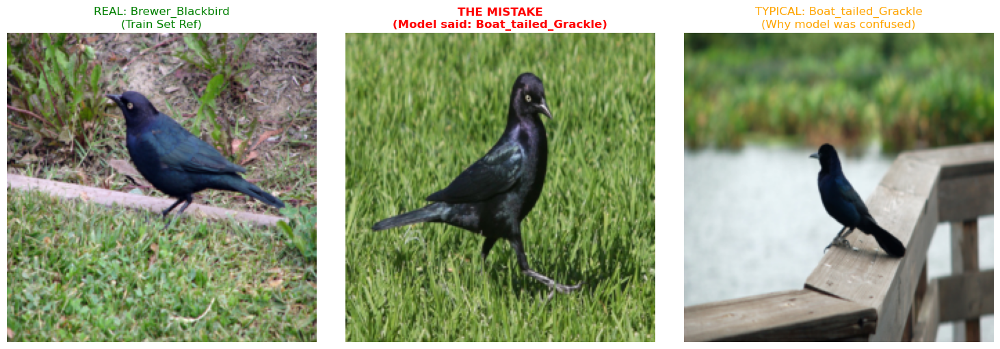

Inspecting: True 'American_Crow' vs Pred 'Common_Raven'


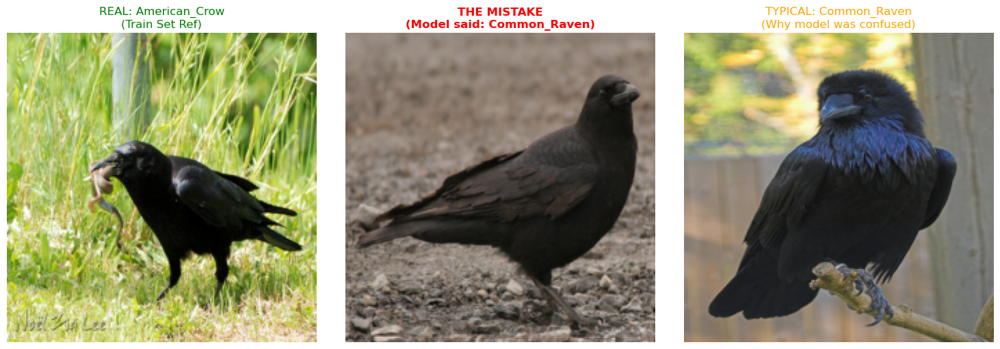

Inspecting: True 'Olive_sided_Flycatcher' vs Pred 'Western_Wood_Pewee'


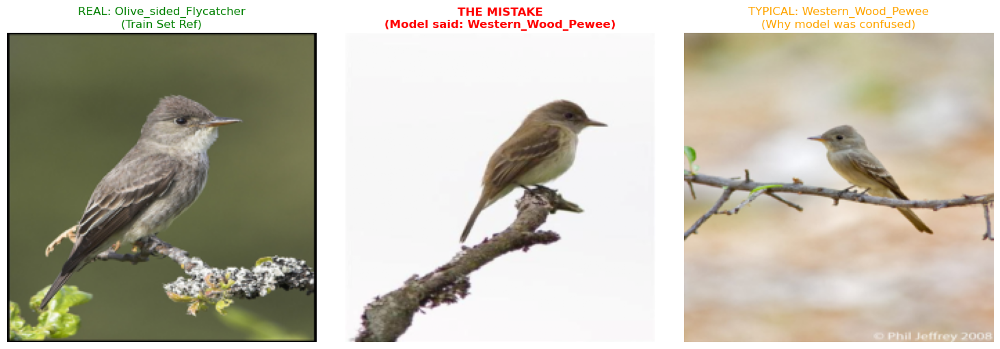

Inspecting: True 'Herring_Gull' vs Pred 'Ring_billed_Gull'


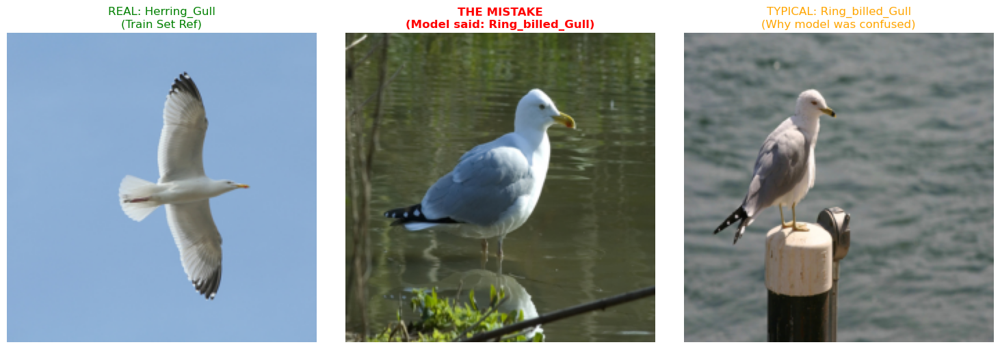

In [14]:
for i in range(min(10, len(df_conf))):
    row = df_conf.iloc[i]
    plot_mistake(row['True Bird'], row['Predicted Bird'])

In [15]:
class GradCAM:
    def __init__(self, model, target_layer):
        self.model = model
        self.target_layer = target_layer
        self.gradients = None
        
        target_layer.register_forward_hook(self.save_activation)
        target_layer.register_backward_hook(self.save_gradient)

    def save_activation(self, module, input, output):
        self.activation = output

    def save_gradient(self, module, grad_input, grad_output):
        self.gradients = grad_output[0]

    def __call__(self, x, class_idx=None):
        self.model.zero_grad()
        output = self.model(x)
        
        if class_idx is None:
            class_idx = torch.argmax(output)
            
        output[0, class_idx].backward()
        
        pooled_gradients = torch.mean(self.gradients, dim=[0, 2, 3])
        activation = self.activation[0]
        
        for i in range(activation.shape[0]):
            activation[i, :, :] *= pooled_gradients[i]
            
        heatmap = torch.mean(activation, dim=0).cpu().detach().numpy()
        heatmap = np.maximum(heatmap, 0) 
        if np.max(heatmap) != 0:
            heatmap /= np.max(heatmap)
            
        return heatmap

# Initialize Hook on the last ResNet layer (layer4)
grad_cam = GradCAM(model, model.layer4[-1])

def show_explanation(img_tensor, true_label_name):
    input_tensor = img_tensor.unsqueeze(0).to(device)
    model.eval()
    model.zero_grad()
    
    output = model(input_tensor)
    pred_idx = torch.argmax(output).item()
    pred_name = full_ds.classes[pred_idx].split('.')[-1]
    
    heatmap = grad_cam(input_tensor, class_idx=pred_idx)
    
    heatmap_img = Image.fromarray(heatmap)
    heatmap_img = heatmap_img.resize((224, 224), resample=Image.BILINEAR)
    heatmap_data = np.array(heatmap_img)
    
    # heatmap
    heatmap_colored = plt.cm.jet(heatmap_data)[:, :, :3]
    heatmap_colored = (heatmap_colored * 255).astype(np.uint8)
    
    # Image
    img_denorm = denormalize(img_tensor).permute(1, 2, 0).numpy()
    img_denorm = (np.clip(img_denorm, 0, 1) * 255).astype(np.uint8)
    
    # Blend images
    img_pil = Image.fromarray(img_denorm)
    heatmap_pil = Image.fromarray(heatmap_colored)
    superimposed = Image.blend(img_pil, heatmap_pil, alpha=0.4)
    
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))
    
    axes[0].imshow(img_pil)
    axes[0].set_title(f"True Label:\n{true_label_name}")
    axes[0].axis('off')
    
    axes[1].imshow(heatmap_pil)
    axes[1].set_title("Focus Heatmap")
    axes[1].axis('off')
    
    axes[2].imshow(superimposed)
    color = 'green' if true_label_name in pred_name else 'red'
    axes[2].set_title(f"Prediction: {pred_name}\n(Where model looked)", color=color, fontweight='bold')
    axes[2].axis('off')
    
    plt.show()

c:\Users\jagod\anaconda3\envs\bird_project\lib\site-packages\torch\nn\modules\module.py:1827: FutureWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  self._maybe_warn_non_full_backward_hook(args, result, grad_fn)


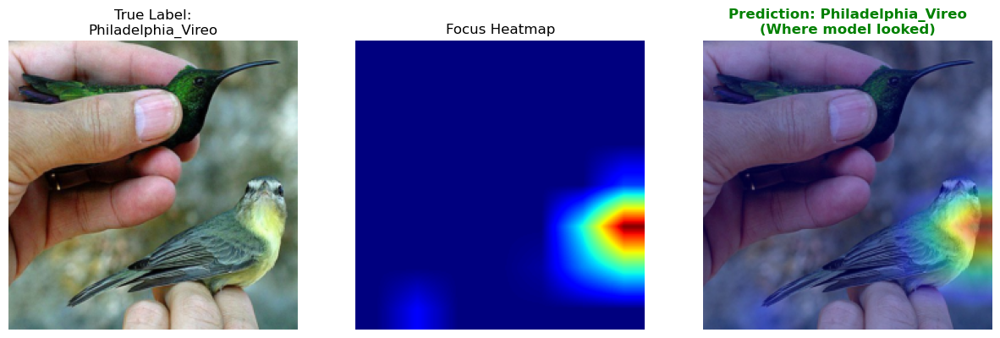

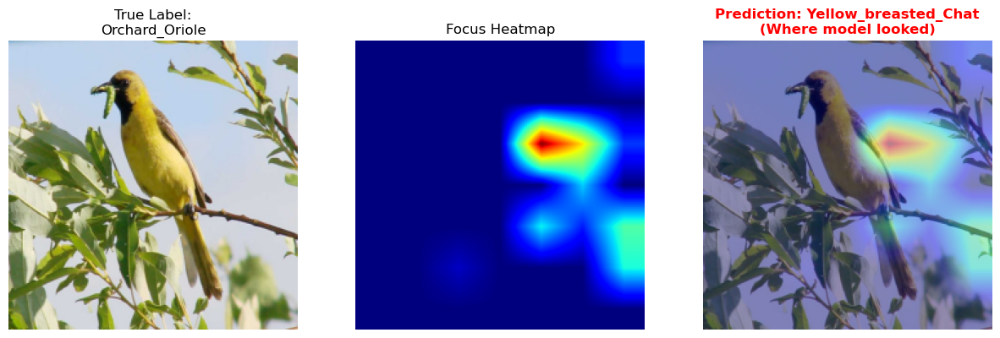

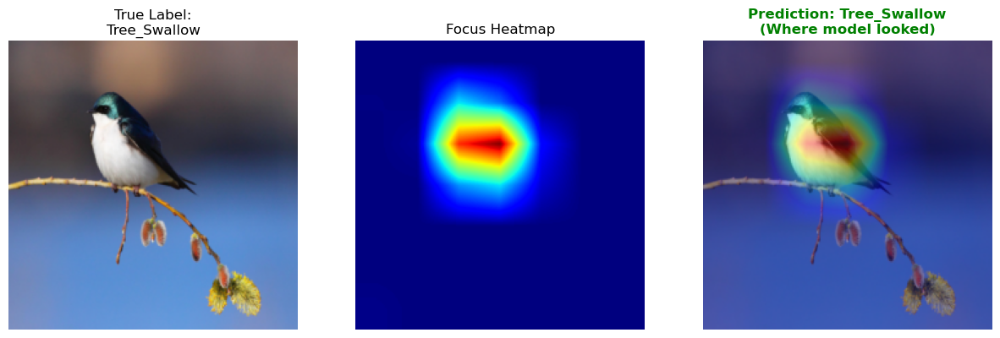

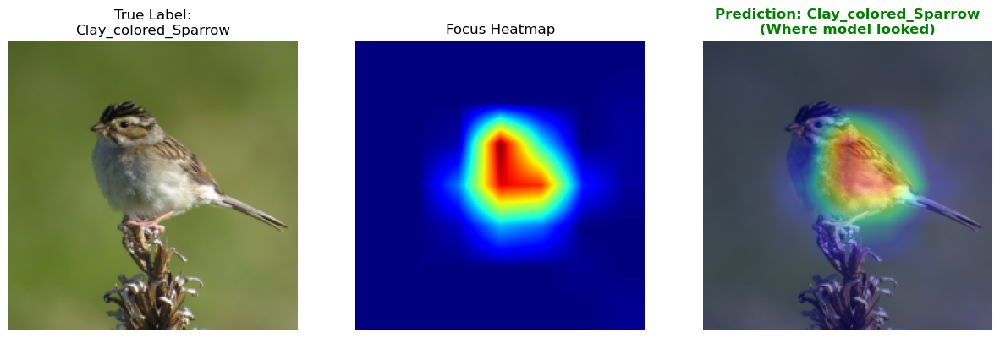

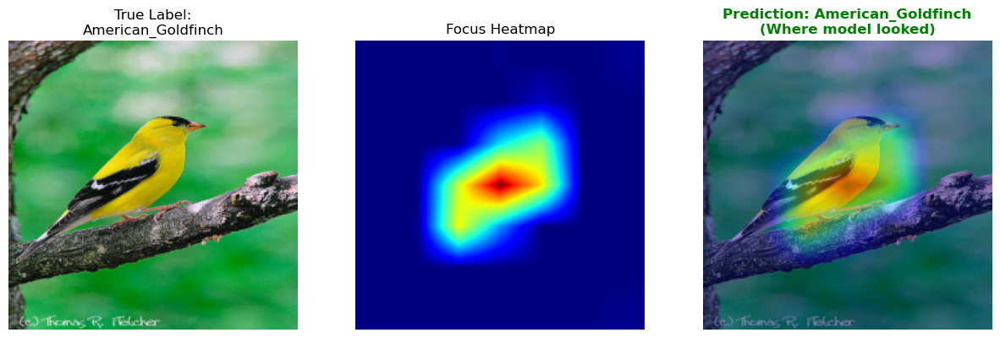

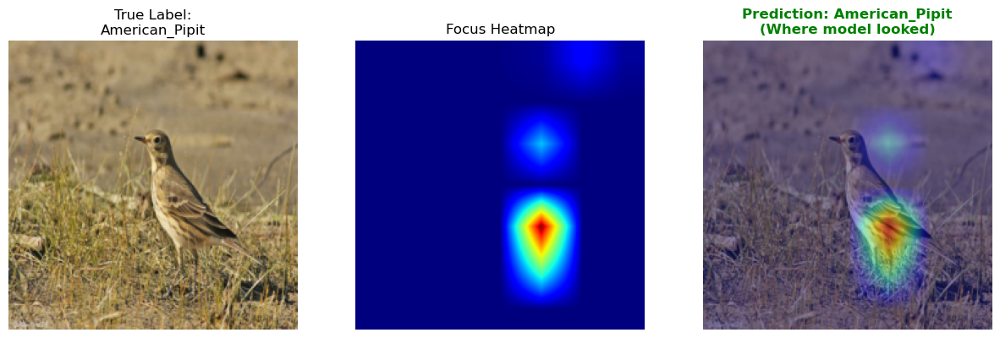

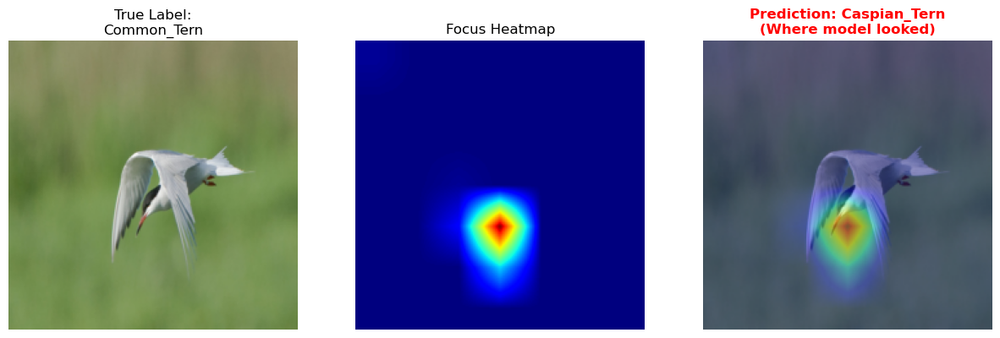

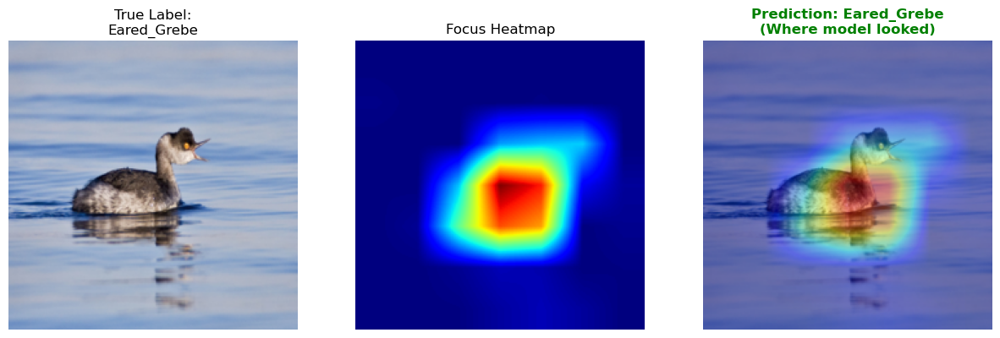

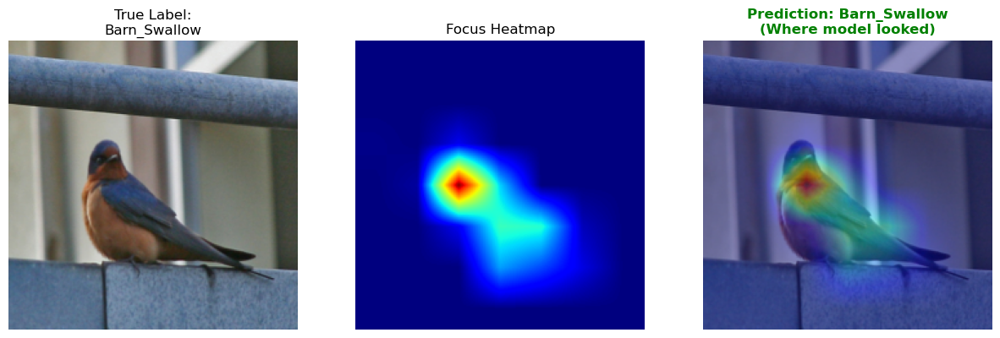

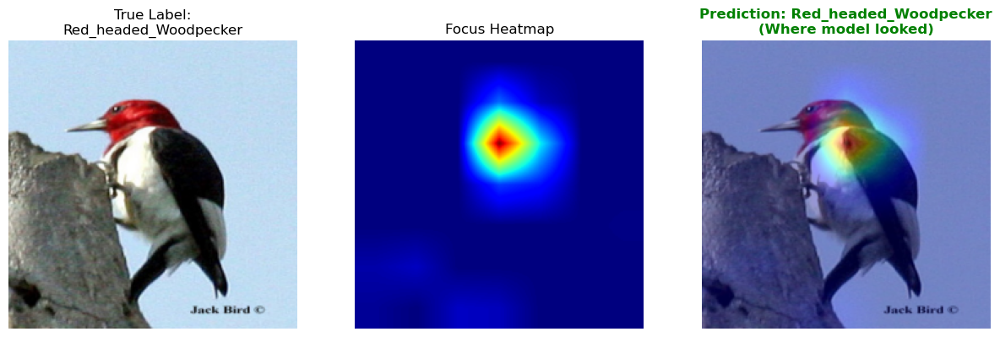

In [16]:
# TEST ON RANDOM IMAGES
import random
indices = random.sample(range(len(test_ds)), 10)

for idx in indices:
    img, label_idx = test_ds[idx]
    label_name = full_ds.classes[label_idx].split('.')[-1]
    show_explanation(img, label_name)